<!--NOTEBOOK_HEADER-->
*This notebook contains material from [cbe61622](https://jckantor.github.io/cbe61622);
content is available [on Github](https://github.com/jckantor/cbe61622.git).*


<!--NAVIGATION-->
< [8.4 RPI Library tests](https://jckantor.github.io/cbe61622/08.04-rpi-test-libraries.html) | [Contents](toc.html) | [9.0 Enabling the Internet of Things](https://jckantor.github.io/cbe61622/09.00-Enabling_the_Internet_of_Things.html) ><p><a href="https://colab.research.google.com/github/jckantor/cbe61622/blob/master/docs/08.05-rpi-picamera_test.ipynb"> <img align="left" src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in Colab" title="Open in Google Colaboratory"></a><p><a href="https://jckantor.github.io/cbe61622/08.05-rpi-picamera_test.ipynb"> <img align="left" src="https://img.shields.io/badge/Github-Download-blue.svg" alt="Download" title="Download Notebook"></a>

# 8.5 RPI Camera Module

The Raspberry Pi Foundation provides support for the use of Raspberry Pi Camera modules on various devices, including the Raspberry Pi 4B. Documentation can be found [here](https://www.raspberrypi.com/documentation/accessories/camera.html).

High resolution images require additional gpu_mem. This can be set using the command line ``raspi-config`` under performance options.

## 8.5.1 PiCamera

[PiCamera](https://picamera.readthedocs.io/en/release-1.13/api_camera.html) is a pure Python library providing access to the Raspberry Pi Camera module. PiCamera is included in the default Raspbian distribution.

In [90]:
# test for camera presence
import picamera

with picamera.PiCamera() as cam:
    print(cam.revision)

imx477


### 8.5.1.1 Camera preview

Camera preview combined with a digital zoom features provides a useful means of acheiving critical focus. Documentation for ``PiCamera.zoom = (a, b, c, d)``, however, is sketchy. With a bit of experimentation, the parameters appear to represent

* a, b: Upper left corner of the zoom frame measured as fraction of the overall frame. Should be floating point numbers between 0 and 1.
* c, d: The extent of the zoom frame measured in the same units between 0 and 1.

In [114]:
# preview image on screen -- focus camera
import picamera
import time

with picamera.PiCamera() as camera:
    camera.start_preview()
    time.sleep(1)
    
    # zoom in effect
    for k in range(0, 950):
        camera.zoom = (k/2000, k/2000, (1000-k)/1000, (1000-k)/1000)
        time.sleep(0.01)
    time.sleep(20)

In [119]:
# capturing images to files
import picamera
import time

N = 5
with picamera.PiCamera() as camera:
    camera.start_preview()
    time.sleep(2)
    tic = time.time()
    for k in range(0, N):
        camera.resolution = (4056, 3040)
        camera.capture(f"test{k}.jpg")
    toc = time.time()
    print(f"fps = {(toc-tic)/N}")

fps = 1.6322479248046875


### 8.5.1.2 Capture to stream and display

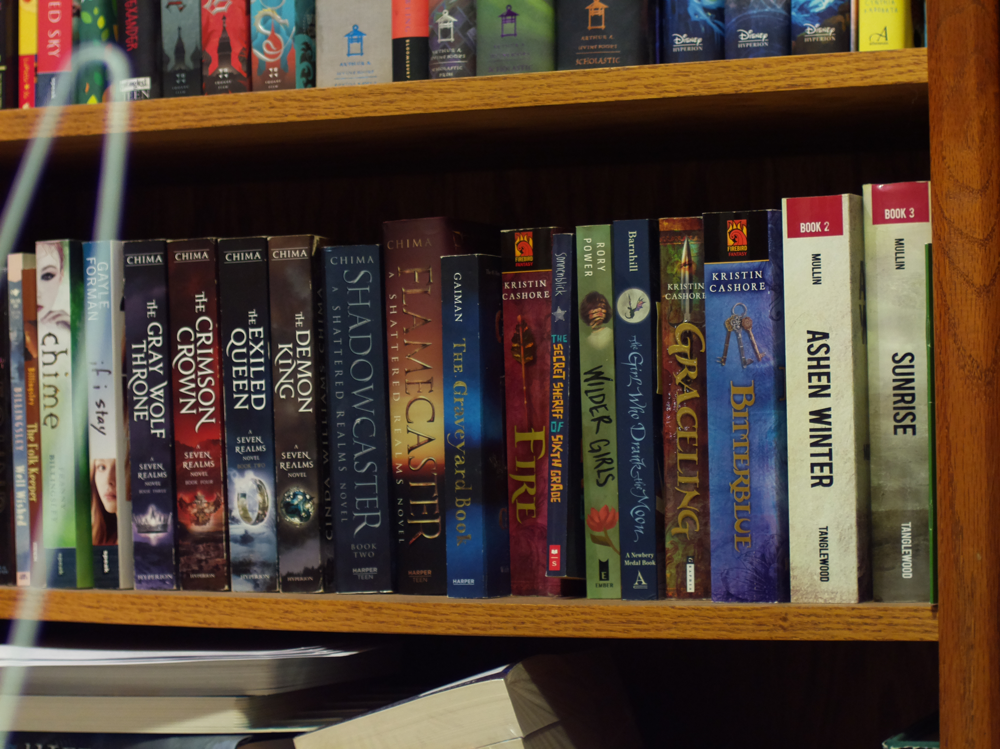

In [7]:
# capture high resolution image to a stream
from io import BytesIO
import picamera
import time
import PIL.Image

# capture image to stream
stream = BytesIO()
with picamera.PiCamera() as camera:
    camera.resolution = (4056, 3040)
    camera.start_preview()
    time.sleep(2)
    camera.capture(stream, format="jpeg")

# rewind stream
stream.seek(0)

# display image
with PIL.Image.open(stream) as im:
    display(im)

### 8.5.1.3 Camera Settings

In [17]:
import picamera
import time

with picamera.PiCamera() as camera:
    camera.start_preview()
    time.sleep(1)
    print(camera.resolution)
    print(camera.exposure_mode)
    print(camera.meter_mode)
    print("Shutter speed = ", camera.exposure_speed/1000000, "secs")
    print(camera.analog_gain)
    print(camera.digital_gain)
    print(camera.iso)
    print(camera.awb_gains)

800x480
auto
average
Shutter speed =  0.032979 secs
8
365/256
0
(Fraction(243, 128), Fraction(369, 128))


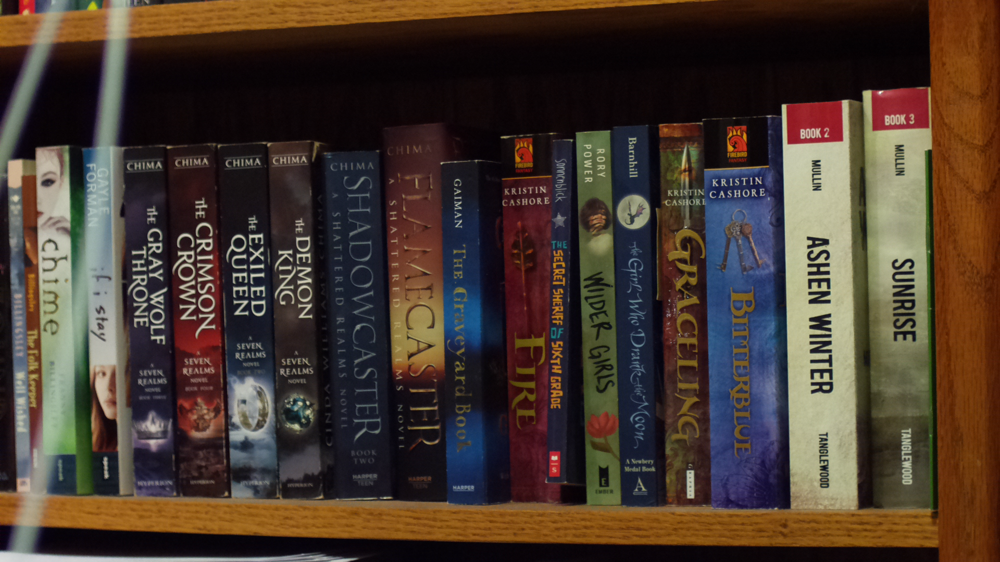

In [37]:
import picamera
import time
import PIL.Image

with picamera.PiCamera() as camera:
    camera.start_preview()
    camera.resolution = "1080p"
    camera.shutter_speed = 200000
    camera.iso = 800
    camera.capture("mypic.png")
    
with PIL.Image.open("mypic.png") as im:
    display(im)

### 8.5.1.4 Capture to numpy array

In [59]:
import time
import picamera
import numpy as np

with picamera.PiCamera() as camera:
    camera.resolution = (1920, 1088)
    camera.framerate = 24
    output = np.empty((1088, 1920, 3), dtype=np.uint8)
    camera.capture(output, 'rgb')

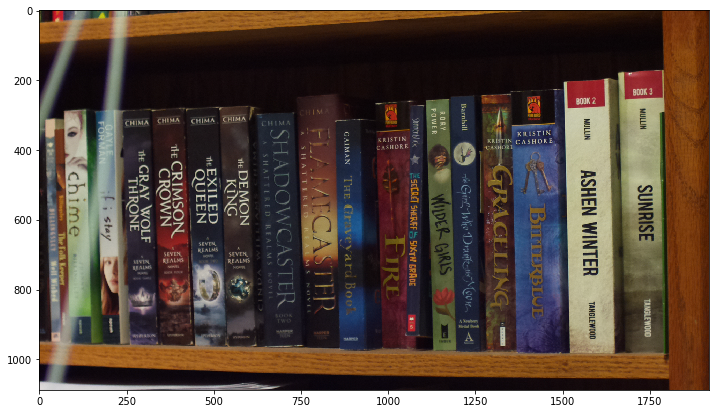

In [60]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.imshow(output)

In [80]:
import time
import picamera
import numpy as np
import cv2
import matplotlib.pyplot as plt

with picamera.PiCamera() as camera:
    camera.resolution = (1920, 1088)
    camera.framerate = 24
    img = np.empty((1088, 1920, 3), dtype=np.uint8)
    camera.capture(img, 'bgr')
    img = img.reshape((1088, 1920, 3))
    

ValueError: too many values to unpack (expected 2)

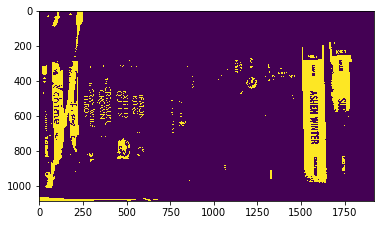

In [89]:
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(img_gray, 150, 255, cv2.THRESH_BINARY)
plt.imshow(thresh)

contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

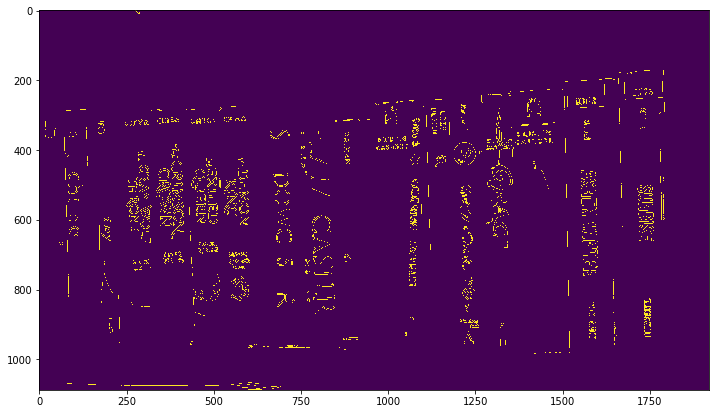

In [80]:

img_blur = cv2.GaussianBlur(img_gray, (3,3), 0)
edges = cv2.Canny(image=img_blur, threshold1=100, threshold2=300)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.imshow(edges)

#### 8.5.1.4.1 

In [85]:
contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)
image_copy = image.copy()
6
cv2.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(0, 255, 0), thickness=2, lineType=cv2.LINE_AA)
7
                
8
# see the results
9
cv2.imshow('None approximation', image_copy)
10
cv2.waitKey(0)
11
cv2.imwrite('contours_none_image1.jpg', image_copy)
12
cv2.destroyAllWindows()


[255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 255,
 2

<!--NAVIGATION-->
< [8.4 RPI Library tests](https://jckantor.github.io/cbe61622/08.04-rpi-test-libraries.html) | [Contents](toc.html) | [9.0 Enabling the Internet of Things](https://jckantor.github.io/cbe61622/09.00-Enabling_the_Internet_of_Things.html) ><p><a href="https://colab.research.google.com/github/jckantor/cbe61622/blob/master/docs/08.05-rpi-picamera_test.ipynb"> <img align="left" src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in Colab" title="Open in Google Colaboratory"></a><p><a href="https://jckantor.github.io/cbe61622/08.05-rpi-picamera_test.ipynb"> <img align="left" src="https://img.shields.io/badge/Github-Download-blue.svg" alt="Download" title="Download Notebook"></a>